In [1]:

import plotly.express as px
from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns
import scipy.stats as stats
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import math
from sklearn.model_selection import train_test_split
import plotly.io as pio
from yellowbrick.cluster import SilhouetteVisualizer

## STATYSTYKA OPISOWA


### Wczytanie danych i rozbicie na dataframe z wartościami nuemrycznymi i metadanymi

In [4]:
#trzeba podmienić na swoja ściezke
df=pd.read_csv("C:/Users/User/Desktop/pca projekt/SpotifyAudioFeaturesApril2019.csv")
print(df.columns)
#rozbicie dfa na dwa jeden z labelami piosenka/autow drugi z dnaymi nuemrycnzymi
df_label=df[['artist_name','track_id','track_name']]
df_num=df.drop(columns=['artist_name','track_id','track_name'])
print(df_num.head(),'\n')
print(df_label.head())

Index(['artist_name', 'track_id', 'track_name', 'acousticness', 'danceability',
       'duration_ms', 'energy', 'instrumentalness', 'key', 'liveness',
       'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence',
       'popularity'],
      dtype='object')
   acousticness  danceability  duration_ms  energy  instrumentalness  key  \
0      0.005820         0.743       238373   0.339             0.000    1   
1      0.024400         0.846       214800   0.557             0.000    8   
2      0.025000         0.603       138913   0.723             0.000    9   
3      0.029400         0.800       125381   0.579             0.912    5   
4      0.000035         0.783       124016   0.792             0.878    7   

   liveness  loudness  mode  speechiness    tempo  time_signature  valence  \
0    0.0812    -7.678     1       0.4090  203.927               4    0.118   
1    0.2860    -7.259     1       0.4570  159.009               4    0.371   
2    0.0824    -5.890     0 

### Eksploracja danych

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 130663 entries, 0 to 130662
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      130663 non-null  float64
 1   danceability      130663 non-null  float64
 2   duration_ms       130663 non-null  int64  
 3   energy            130663 non-null  float64
 4   instrumentalness  130663 non-null  float64
 5   key               130663 non-null  int64  
 6   liveness          130663 non-null  float64
 7   loudness          130663 non-null  float64
 8   mode              130663 non-null  int64  
 9   speechiness       130663 non-null  float64
 10  tempo             130663 non-null  float64
 11  time_signature    130663 non-null  int64  
 12  valence           130663 non-null  float64
 13  popularity        130663 non-null  int64  
dtypes: float64(9), int64(5)
memory usage: 14.0 MB
None

 NAN COUNT 
 acousticness        0
danceability        0
duratio

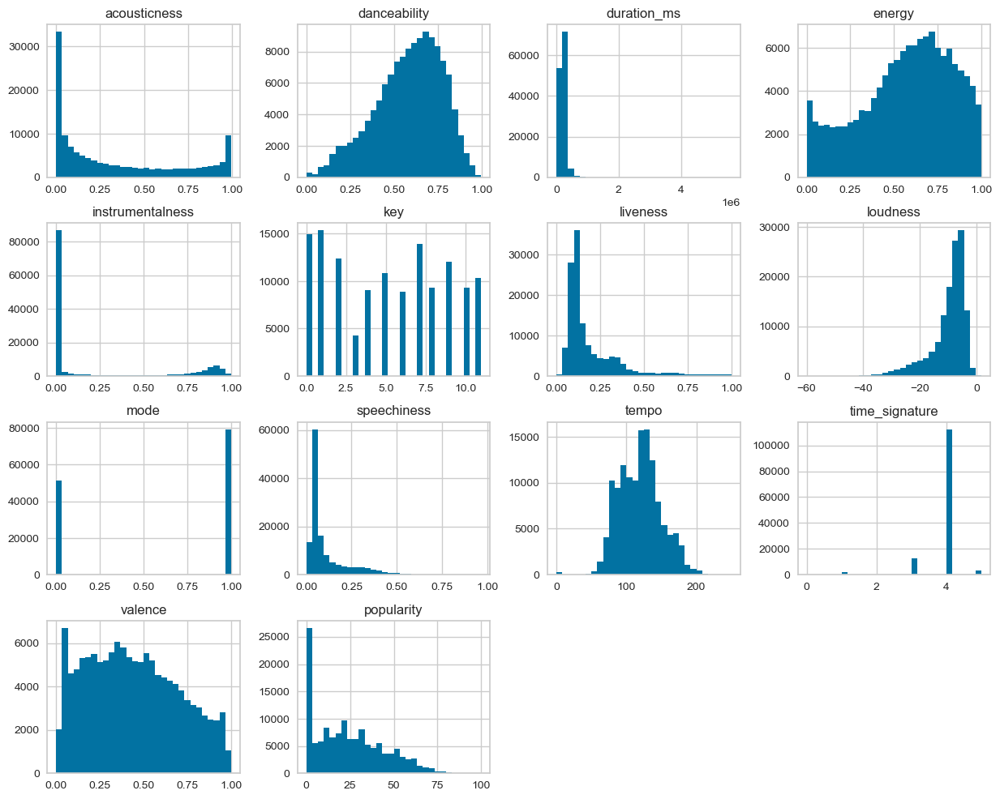

-----procent 0----- 
 acousticness         0.035205
danceability         0.223476
duration_ms          0.000000
energy               0.014541
instrumentalness    32.245548
key                 11.458485
liveness             0.023725
loudness             0.000765
mode                39.226101
speechiness          0.223476
tempo                0.223476
time_signature       0.228833
valence              0.255619
popularity          14.456273
dtype: float64
-------procent 1----- 
 acousticness         0.000000
danceability         0.000000
duration_ms          0.000000
energy               0.145412
instrumentalness     0.018368
key                 11.746248
liveness             0.000000
loudness             0.000000
mode                60.773899
speechiness          0.000000
tempo                0.000000
time_signature       1.338558
valence              0.006888
popularity           2.462059
dtype: float64

 ---------wartosci ujemne------------- 
 acousticness         0.00000
danceability 

In [6]:
print(df_num.info())
column_nan_count = df_num.isnull().sum()
print('\n','NAN COUNT','\n',column_nan_count) #ilość NaN

#brak NaN wiec nie mamy co usuwac, zmieniam wszystko na float 64
df_num=df_num.astype(np.float64)

df_num.hist(bins=30, figsize=(15, 12))
plt.savefig('moje_histogramy.png', dpi=300, bbox_inches='tight')
plt.show()
a=(df_num == 0).sum()
b=df_num.count()
print('-----procent 0-----','\n',a/b * 100)#tyle procent danych w kazdej kolumnie to 0.

print('-------procent 1-----','\n', (df_num==1).sum()/df_num.count()*100) #tyle procent to 1

c=(df_num<0).sum()/df_num.count() *100 #ile jest wartosci ujemnych
print('\n','---------wartosci ujemne-------------','\n',c)
print('\n','----procent >1---','\n',(df_num>1).sum()/df_num.count()*100) #tyle pocent jest wieksza od 1
#kazda obserwacja poza instrumentalness, key, mode i popularity ma tak malo 0 ze mozna je zignorowac w liczeniu dopasownia rozkladu tj. formlanie bedzie to rozklad dla X|X>0

#### Df bez 0

Potrzebny będzię później

In [8]:
df_no_zeros = df_num[(df_num != 0).all(axis=1)] #wywalamy 0

### Testy statystyczne
Teraz będziemy testować hipotezy dla naszych danych numerycznych. Nie posiadam żadnej dodatkowej wiedzy apriori ani założeń co do naszych danych, histogramy zaś nie wskazują jednoznacznie na żaden rozkład; z tego względu decyduje się na testy nieparametryczne. Najpopularniejszy test nieparametryczny to prawodpodobnie test KS, jednak ze względu na wielkość próby zdecydowałem się na test AD. DOdatkowo warto zaznaczyć, że nasza próba jest bardzo duża(N=130663) z tego względu każdy test statystyczny będzie prawdopodobnie zbyt czuły i zawsze odrzucimy H0. Z tego względu poslużymy się QQ plotami w dalszej części. 

Przyjęto: 
Poziom istotnośći: 0,01. Przy dużych danych lepiej być konserwatywnym. 

H0: dane pochodzą z danego rozkładu.

Metoda stats.anderson przyjmuje tylko kilka rozkładów jak normalny, wykładniczy, logistyczny. Nie uważam za zasadne rozszerzanie tych rozkładów gdyż i tak testy odrzucą H0 przy takiej próbie. Te wyniki mają pokazać ograniczenia testów statsytycznych.

Testy są przeprowadzane zarówno na danych niezmienionych jak i na danych bez 0 i na danych bez 0 i 1.

Dlaczego:
Większość zmiennych ma nośnik [0,1] przy dopaoswywaniu QQ plotów na rozkład np. Gamma czy Lognormalny te wartości psują obliczenia numeryczne. WIęcej o tym w sekcji z QQ Plotami. Żeby móc również porównać QQ ploty z testami statystycznymi trzeba bylo je również wykonać na spreparowanych pod nie danych. Formalnie rzecz ujmując testy są przeprowadzone dla rozkkładów:

$$X$$ oraz $$X \mid 0<X$$ oraz $$X \mid 0<X<1$$

Logika stojąca za tymi przekształceniami znajduję się niżej


In [10]:

'''funkcja do tetsownaia anderosnem dalrigiem dla 
1) jakiegos juz oczyszczonego dfa
2) ustalonego significance_level
'''
cleaned_cols = []
for x in df_num.columns:
    s = df_num[x][(df_num[x] > 0) & (df_num[x] < 1)]
    cleaned_cols.append(s)
    ######to na gorze jest po to zbey testowac bez 0 i 1
df_mid_global = pd.concat(cleaned_cols, axis=1)

def Anderson_Darling_TEST(data, significance_level,typ):
    test_df_norm=pd.DataFrame(
    index=data.columns,
    columns=['Significance Level','Critical Values','Test Statistic', 'Decision']
)
    mapping={15: 0, 10: 1, 5: 2, 2.5: 3, 1: 4}
    idx=mapping[significance_level] #wez significance level 
    for i,x in enumerate(data.columns):
        result1 = stats.anderson(data[x].dropna(), dist=typ)
        test_df_norm.iloc[i,0]=f'Sig. LVL: {significance_level}%'
        test_df_norm.iloc[i,1]=result1.critical_values[idx]
        test_df_norm.iloc[i,2]=result1.statistic
        decision=''
        if result1.statistic<result1.critical_values[idx]:
            decision=' DONT REJECT H0'
        else:
            decision='REJECT H0'
        test_df_norm.iloc[i,3]=decision
    return test_df_norm

    
 # tu do zmiany wyswietlany kod to tlyko snippety
print('ANDERSON-DARLING TEST NORMAL','\n\n',Anderson_Darling_TEST(df_num,1,'norm'),'\n')
print('ANDERSON-DARLING TEST LOGISTIC','\n\n',Anderson_Darling_TEST(df_num,1,'logistic'),'\n')
print('ANDERSON-DARLING TEST EXP', '\n\n',Anderson_Darling_TEST(df_num,1,'expon'), '\n')


print('ANDERSON-DARLING TEST WITHOUT 0s NORMAL','\n\n',Anderson_Darling_TEST(df_no_zeros,1,'norm'),'\n')
print('ANDERSON-DARLING TEST  WITHPUT 0 EXP','\n\n',Anderson_Darling_TEST(df_no_zeros,1,'expon'),'\n')






test_series=-df_no_zeros['loudness']
test_series=test_series[test_series>0]
result=stats.anderson(test_series, dist='logistic')
result2=stats.anderson(test_series, dist='expon')
print('logistic for loudness:-----',result.critical_values,'-----',result.statistic,'\n')
print('exponential for loudness: -----',result2.critical_values,'-----',result2.statistic,'\n')



ANDERSON-DARLING TEST NORMAL 

                  Significance Level Critical Values Test Statistic   Decision
acousticness           Sig. LVL: 1%           1.092    7437.624015  REJECT H0
danceability           Sig. LVL: 1%           1.092     830.750661  REJECT H0
duration_ms            Sig. LVL: 1%           1.092    7993.351324  REJECT H0
energy                 Sig. LVL: 1%           1.092    1227.586709  REJECT H0
instrumentalness       Sig. LVL: 1%           1.092   23724.204988  REJECT H0
key                    Sig. LVL: 1%           1.092    2861.090528  REJECT H0
liveness               Sig. LVL: 1%           1.092    11837.19011  REJECT H0
loudness               Sig. LVL: 1%           1.092    6577.745947  REJECT H0
mode                   Sig. LVL: 1%           1.092   24931.834973  REJECT H0
speechiness            Sig. LVL: 1%           1.092   14727.982035  REJECT H0
tempo                  Sig. LVL: 1%           1.092      304.72968  REJECT H0
time_signature         Sig. LVL:

C:\Users\User\anaconda3\Lib\site-packages\scipy\stats\_morestats.py:2248: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s


Jak widać testy zawsze odrzucą hipotezy

### QQ Ploty
Postanowiłem zrobić QQ ploty dla rozkladów
1) Beta
2) Normalnego
3) LogNormalnego

Dla rozkładu Beta wybieram te dane które już są na [0,1]. 


In [13]:
#wezmy te kolumny gdzie najnizsza wartosc to 0 a najwyzsza to 1
n=list()
for x in df_num.columns:
    if df_num[x].between(0,1).all():
        n.append(x)
print(n)
#mode to 0 lub 1 wiec wyrzucam
n.remove('mode')


['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'mode', 'speechiness', 'valence']


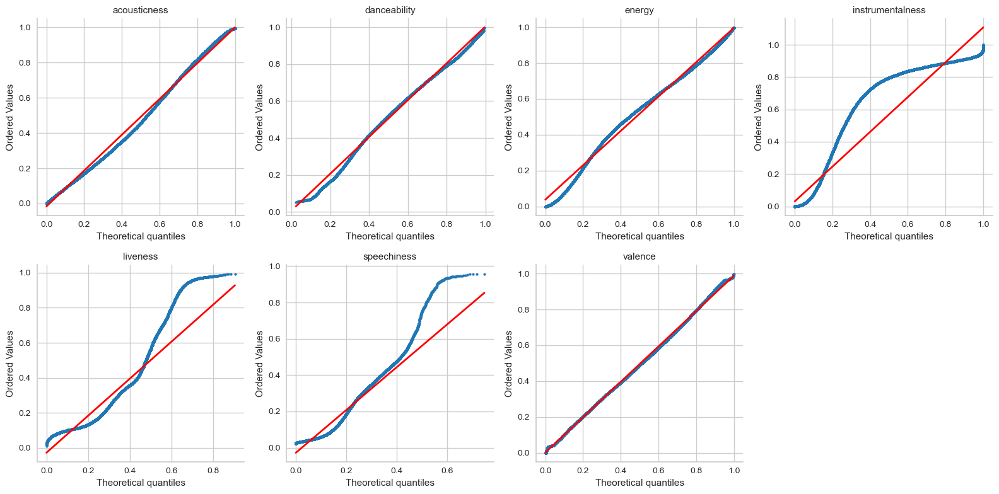

In [14]:
k = len(n)
ncols = 4
nrows = int(np.ceil(k / ncols))

fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4*nrows))
axes = np.array(axes).ravel()

for i, x in enumerate(n):
    ax = axes[i]

    s_mid = df_num[x][(df_num[x] > 0) & (df_num[x] < 1)]
    s_train, s_test = train_test_split(s_mid, test_size=0.30, random_state=42)
    params = stats.beta.fit(s_train, floc=0, fscale=1)

    stats.probplot(s_test, dist='beta', sparams=params, plot=ax)

    # styl punktów
    ax.get_lines()[0].set_markerfacecolor('#1f77b4')
    ax.get_lines()[0].set_markeredgecolor('#1f77b4')
    ax.get_lines()[0].set_markersize(3)

    # styl linii
    ax.get_lines()[1].set_color('red')
    ax.get_lines()[1].set_linewidth(2)

    ax.set_title(x, fontsize=11)
    sns.despine(ax=ax)

# wyłącz puste osie
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()




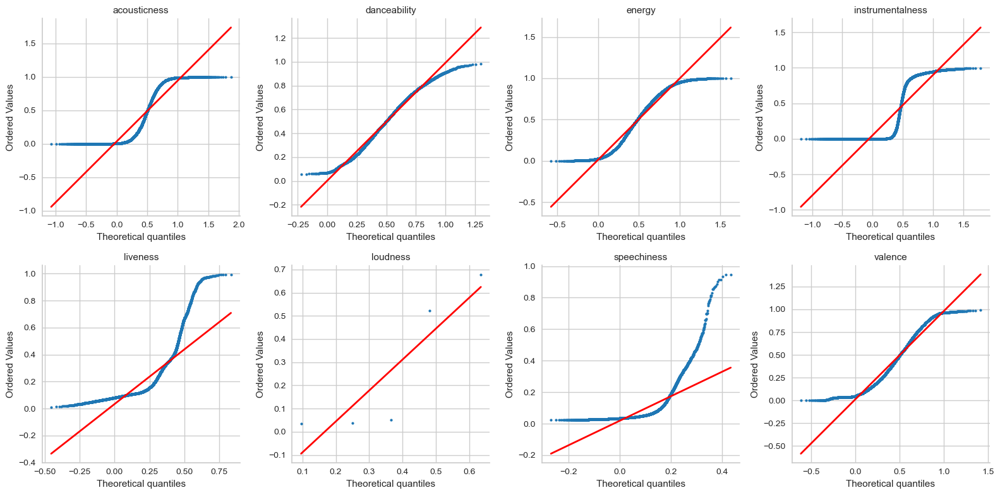

In [15]:

df_cont = df_no_zeros.drop(columns=['mode', 'time_signature', 'key'])
cols_to_plot = [col for col in df_cont.columns if ((df_cont[col] > 0) & (df_cont[col] < 1)).any()]

n = len(cols_to_plot)
ncols = 4
nrows = math.ceil(n / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4*nrows))
axes = np.array(axes).ravel()

for i, x in enumerate(cols_to_plot):
    ax = axes[i]
    
    s_mid = df_cont[x][(df_cont[x] > 0) & (df_cont[x] < 1)].dropna()
    s_train, s_test = train_test_split(s_mid, test_size=0.30, random_state=42)

    params=stats.norm.fit(s_train)
    stats.probplot(s_test, dist='norm',sparams=params, plot=ax)

    # Stylizacja (teraz bezpieczna)
    ax.get_lines()[0].set_markerfacecolor('#1f77b4')
    ax.get_lines()[0].set_markeredgecolor('#1f77b4')
    ax.get_lines()[0].set_markersize(3)
    ax.get_lines()[1].set_color('red')
    ax.get_lines()[1].set_linewidth(2)

    ax.set_title(x, fontsize=11)
    sns.despine(ax=ax)
    
for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()




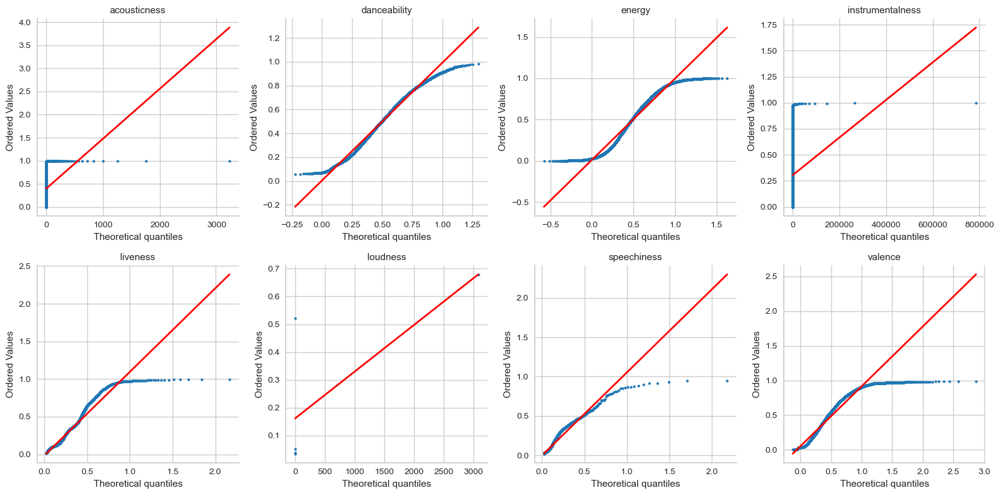

In [16]:
#LOGNORMAL


# 1. Usuwamy kategoryczne zmienne
df_cont = df_no_zeros.drop(columns=['mode', 'time_signature', 'key'])

cols_to_plot = [col for col in df_cont.columns if ((df_cont[col] > 0) & (df_cont[col] < 1)).any()]


n = len(cols_to_plot)
ncols = 4
nrows = math.ceil(n / ncols)
fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 4*nrows))
axes = np.array(axes).ravel()

for i, x in enumerate(cols_to_plot):
    ax = axes[i]

    s_mid = df_cont[x][(df_cont[x] > 0) & (df_cont[x] < 1)].dropna()
    s_train, s_test = train_test_split(s_mid, test_size=0.30, random_state=42)
    params=stats.lognorm.fit(s_train)

    stats.probplot(s_test, dist='lognorm',sparams=params, plot=ax)

    # Stylizacja (teraz bezpieczna)
    ax.get_lines()[0].set_markerfacecolor('#1f77b4')
    ax.get_lines()[0].set_markeredgecolor('#1f77b4')
    ax.get_lines()[0].set_markersize(3)
    ax.get_lines()[1].set_color('red')
    ax.get_lines()[1].set_linewidth(2)

    ax.set_title(x, fontsize=11)
    sns.despine(ax=ax)


for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()





In [17]:

scaler=StandardScaler()
df_std=scaler.fit_transform(df_num)
df_std=pd.DataFrame(
    df_std,
    columns=df_num.columns ,
    index=df_num.index
)

In [18]:
pca=PCA()
df_std_pca= pca.fit_transform(df_std)
explained_variance = pca.explained_variance_ratio_
components=pca.components_
df_variance=pd.DataFrame(
    explained_variance.round(4) * 100 ,
    columns=['Explained Variance %'],
    index=[f'PC{i+1}' for i in range (len(explained_variance))]
)
df_pca_components=pd.DataFrame(
    components.round(3),
    columns=df_std.columns,
    index=[f'PC{i+1}' for i in range (len(components))]
            )
df_std_pca=pd.DataFrame(
    df_std_pca,
    columns=[f'PC{i+1}' for i in range(df_num.shape[1])],
    index=df_std.index
)

df_merged=pd.concat([df_variance,df_pca_components], axis=1)



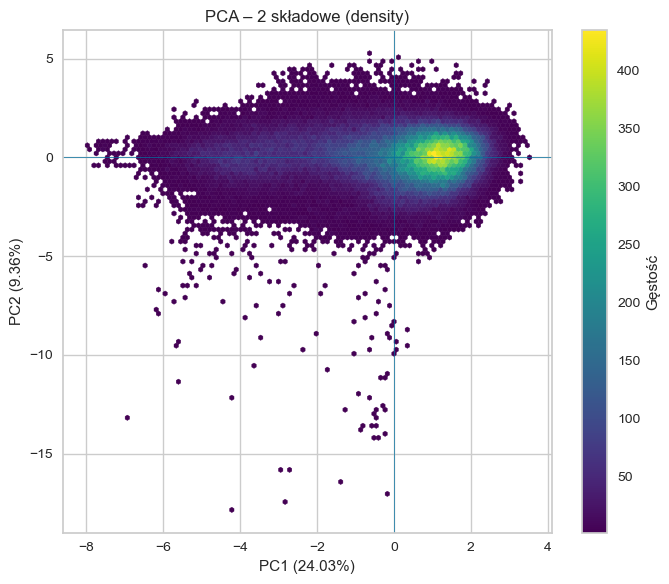

In [19]:
plt.figure(figsize=(7, 6))

hb = plt.hexbin(
    df_std_pca['PC1'], df_std_pca['PC2'],
    gridsize=100,    
    cmap='viridis',
    mincnt=1
)

plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0].round(4)*100}%)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1].round(4)*100}%)')
plt.title('PCA – 2 składowe (density)')

plt.axhline(0, linewidth=0.5)
plt.axvline(0, linewidth=0.5)

plt.colorbar(hb, label='Gęstość')
plt.tight_layout()
plt.show()


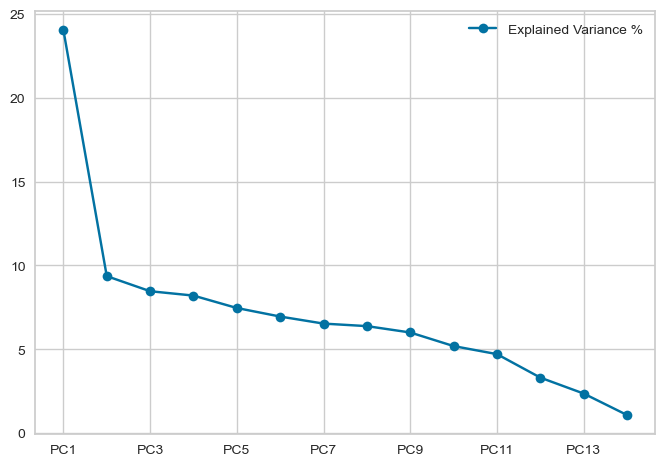

     eigenvalue
PC1    3.363702
PC2    1.309967
PC3    1.184971
PC4    1.147683
PC5    1.044046


In [20]:
df_variance.plot(marker='o')
plt.show()
kaiser=pca.explained_variance_

#wyborilosci PCA kaiserem
df_kaiser=pd.DataFrame(
    kaiser,
    columns=['eigenvalue'],
    index=[f'PC{i+1}' for i in range (len(kaiser))]
)
final_pca=df_kaiser[df_kaiser['eigenvalue']>1]
print((final_pca))

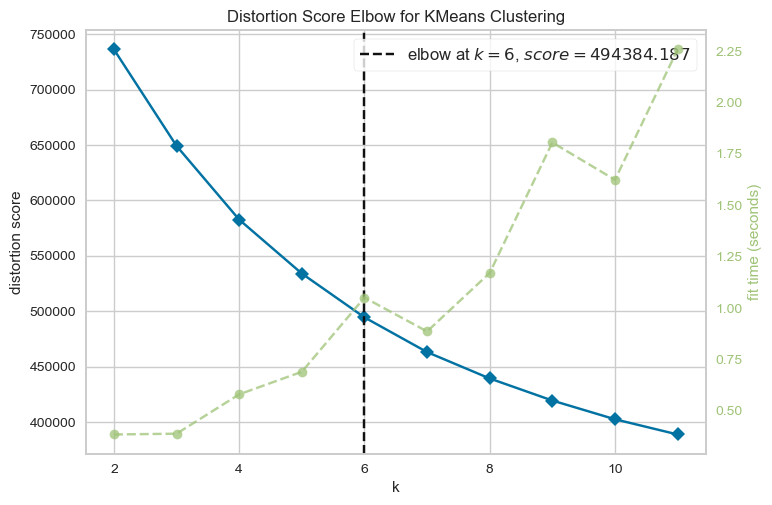

In [21]:
df_clustering = df_std_pca.iloc[:, :len(final_pca)]

kmeans = KMeans(init="k-means++", n_init=10, random_state=0)
visualizer = KElbowVisualizer(kmeans, k=(2, 12))
visualizer.fit(df_clustering)
visualizer.show()
elbow_k = visualizer.elbow_value_

kmeans = KMeans(init="k-means++", n_clusters=elbow_k, n_init=10, random_state=0)


labels = kmeans.fit_predict(df_clustering)


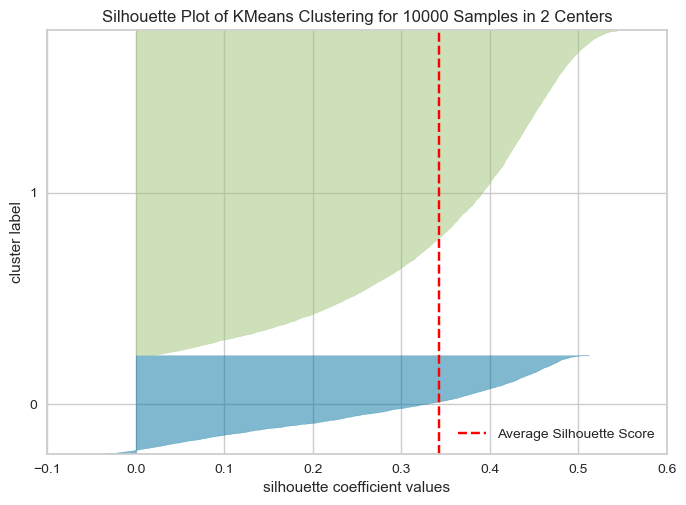

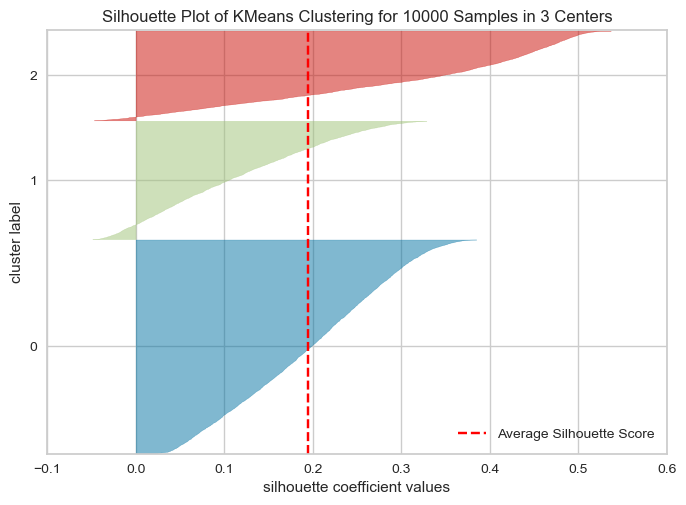

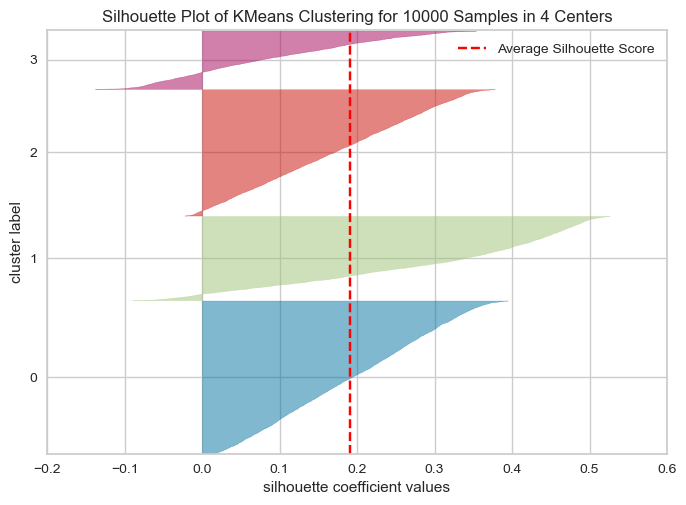

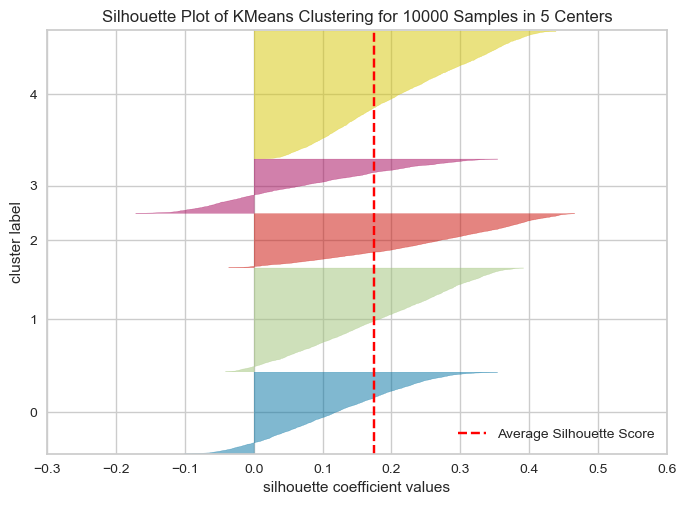

In [22]:
df_sil = df_clustering.sample(10000, random_state=0)

for k in range(2, (df_clustering.shape[1])+1):
    kmeans = KMeans(init="k-means++", n_clusters=k, n_init=10, random_state=0)
    viz = SilhouetteVisualizer(kmeans, colors='yellowbrick')
    viz.fit(df_sil)
    viz.show()

In [23]:
#dataframe taki, że kazda piosenka ma przypsiana nazwe, autora i klaster

df_songs_clusters=pd.DataFrame({'CLusters': labels})
df_songs_clusters['Song Name']=df_label['track_name']
df_songs_clusters['Artist Name']=df_label['artist_name']


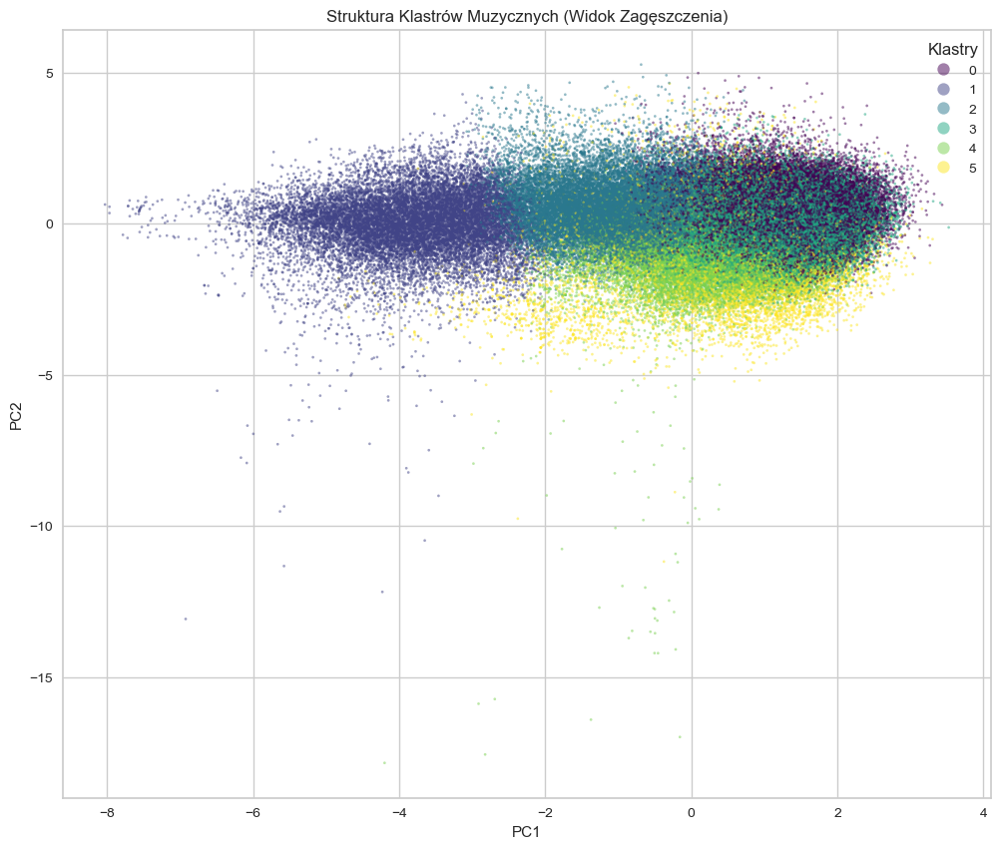

In [24]:

plt.figure(figsize=(12, 10))


sns.scatterplot(
    x=df_clustering.iloc[:, 0], 
    y=df_clustering.iloc[:, 1], 
    hue=labels, 
    palette="viridis", 
    s=3,                
    alpha=0.5,        
    edgecolor=None      
)


plt.legend(title="Klastry", markerscale=5, loc='upper right')

plt.title("Struktura Klastrów Muzycznych (Widok Zagęszczenia)")
plt.savefig('klastry PCA 2D.png')
plt.show()

In [25]:


fig = go.Figure(data=[go.Scatter3d(
    x=df_clustering.iloc[:, 0],
    y=df_clustering.iloc[:, 1],
    z=df_clustering.iloc[:, 2],
    mode='markers',
    marker=dict(
        size=1.2,           
        color=labels,       
        colorscale='Viridis', 
        opacity=0.3         
    )
)])

fig.update_layout(
    scene=dict(
        xaxis=dict(
            title="PC1", 
            autorange='reversed' 
        ),
        yaxis=dict(title="PC2"),
        zaxis=dict(title="PC3")
    ),
    margin=dict(l=0, r=0, b=0, t=0),
    autosize=True,
    template="plotly_white"
)

pio.write_html(fig, file="plot.html", auto_open=False, include_plotlyjs="cdn")
fig.show()

In [60]:
df_merged[:len(final_pca)]

,Explained Variance %,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,popularity
PC1,24.03,-0.412,0.344,-0.059,0.446,-0.321,0.034,0.060,0.471,-0.048,0.150,0.173,0.159,0.279,0.149
PC2,9.36,0.252,0.445,-0.412,-0.306,-0.098,0.030,-0.385,-0.162,-0.013,0.323,-0.157,0.022,0.397,-0.042
PC3,8.46,0.034,0.058,0.113,-0.059,-0.089,-0.600,-0.295,0.087,0.628,-0.239,0.063,0.050,0.021,0.242
PC4,8.20,-0.015,-0.109,-0.301,0.082,-0.049,-0.319,0.577,-0.063,0.331,0.374,-0.040,-0.289,0.101,-0.323
PC5,7.46,0.143,-0.057,0.100,-0.120,-0.434,0.066,0.201,0.046,-0.037,0.208,-0.452,-0.206,-0.186,0.625


In [30]:

pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.expand_frame_repr', False)  
pd.set_option('display.width', 2000)              
pd.set_option('display.max_columns', None)

for i in range(elbow_k):
    subset = df_songs_clusters[df_songs_clusters['CLusters']==i].sample(n=10, random_state=2137)
    print(f'\n---------------- cluster: {i} ----------------')
    print(subset)



---------------- cluster: 0 ----------------
        CLusters                          Song Name     Artist Name
115709         0  Give Me Back My Eyes (feat. Ymtk)       Too $hort
39610          0                           Being Me   Willy Winarko
57869          0                          Þráhyggja           JóiPé
83189          0                            Tu y Yo         Mr. Don
12243          0                             Malibu     Vegas Jones
12699          0           Why Can't We Be Friends?    The Academic
128178         0                     World Wide Web     Chris Webby
121700         0                   Morir Con Estilo     Regulo Caro
26299          0             Wow! You Will Love it!  Invisible Inc.
107243         0                             Letter      Chief Keef

---------------- cluster: 1 ----------------
        CLusters                                          Song Name               Artist Name
20387          1                      Ellens dritter Gesang, D. 83


### K MEANS BEZ PCA


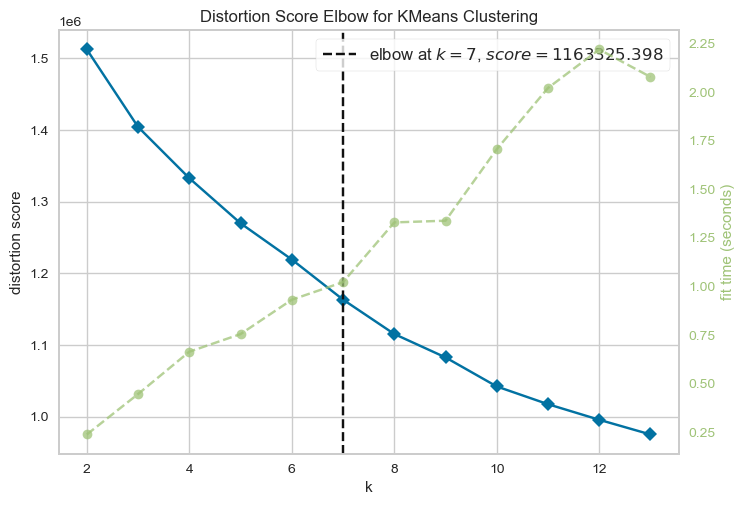

In [32]:
scaler2=StandardScaler()
df_kmeans=scaler2.fit_transform(df_num)

kmeans2 = KMeans( init="k-means++",n_clusters=6, n_init=10, random_state=10)
visualizer = KElbowVisualizer(kmeans2, k=(2, 14))
visualizer.fit(df_kmeans)
visualizer.show()
kmeans2_elbow=visualizer.elbow_value_
kmeans2=KMeans( init="k-means++",n_clusters=kmeans2_elbow, n_init=10, random_state=10)
labels2=kmeans2.fit_predict(df_kmeans)



#### Wykresy


In [34]:

df_songs_clusters_kmeans=pd.DataFrame({'CLusters': labels2})
df_songs_clusters_kmeans['Song Name']=df_label['track_name']
df_songs_clusters_kmeans['Artist Name']=df_label['artist_name']

df_kmeans2=pd.DataFrame(
    df_kmeans,
    index=df_num.index,
    columns=df_num.columns
)

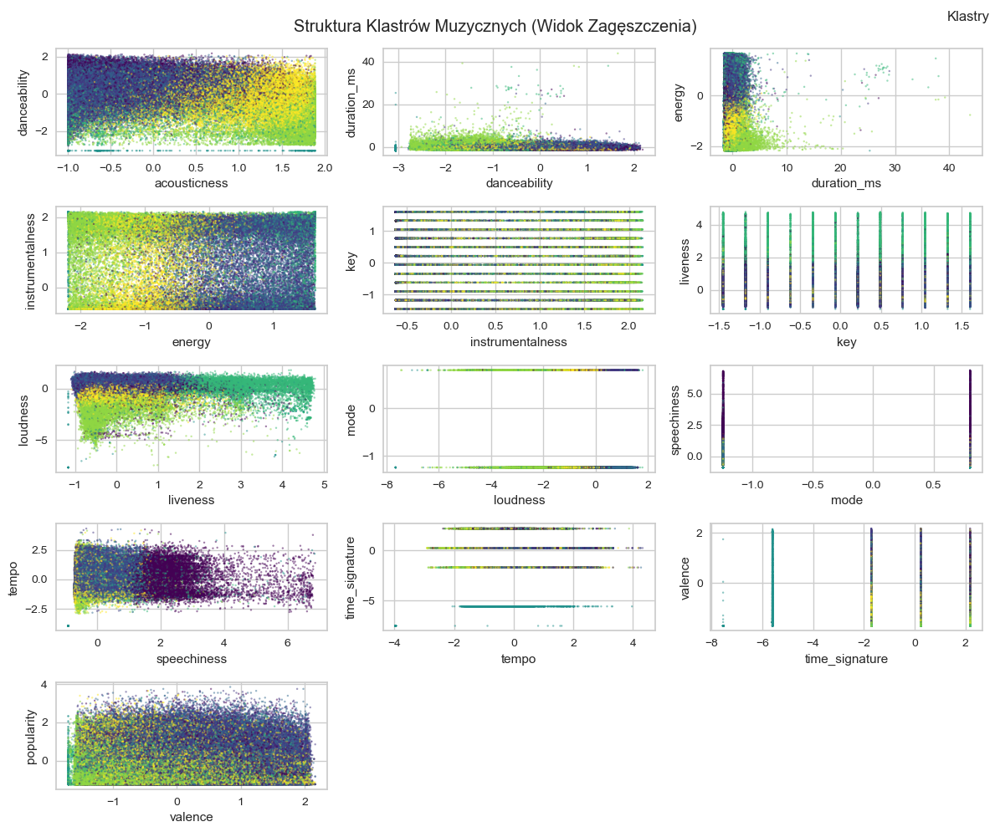

In [35]:
k = len(df_kmeans2.columns) - 1    
ncols = 3
nrows = math.ceil(k / ncols)

fig, axes = plt.subplots(nrows, ncols, figsize=(12, 10))
axes = axes.ravel()

for i in range(k):
    ax = axes[i]

    sns.scatterplot(
        x=df_kmeans2.iloc[:, i],
        y=df_kmeans2.iloc[:, i+1],
        hue=labels2,
        palette="viridis",
        s=3,
        alpha=0.5,
        edgecolor="none",
        legend=False,
        ax=ax      
    )
    
for j in range(k, len(axes)):
    axes[j].axis("off")


handles, leg_labels = axes[0].get_legend_handles_labels()
fig.legend(handles, leg_labels, title="Klastry", markerscale=5, loc="upper right")

fig.suptitle("Struktura Klastrów Muzycznych (Widok Zagęszczenia)")
plt.tight_layout()
plt.savefig('Kmeans bez PCA obrazki.png')
plt.show()

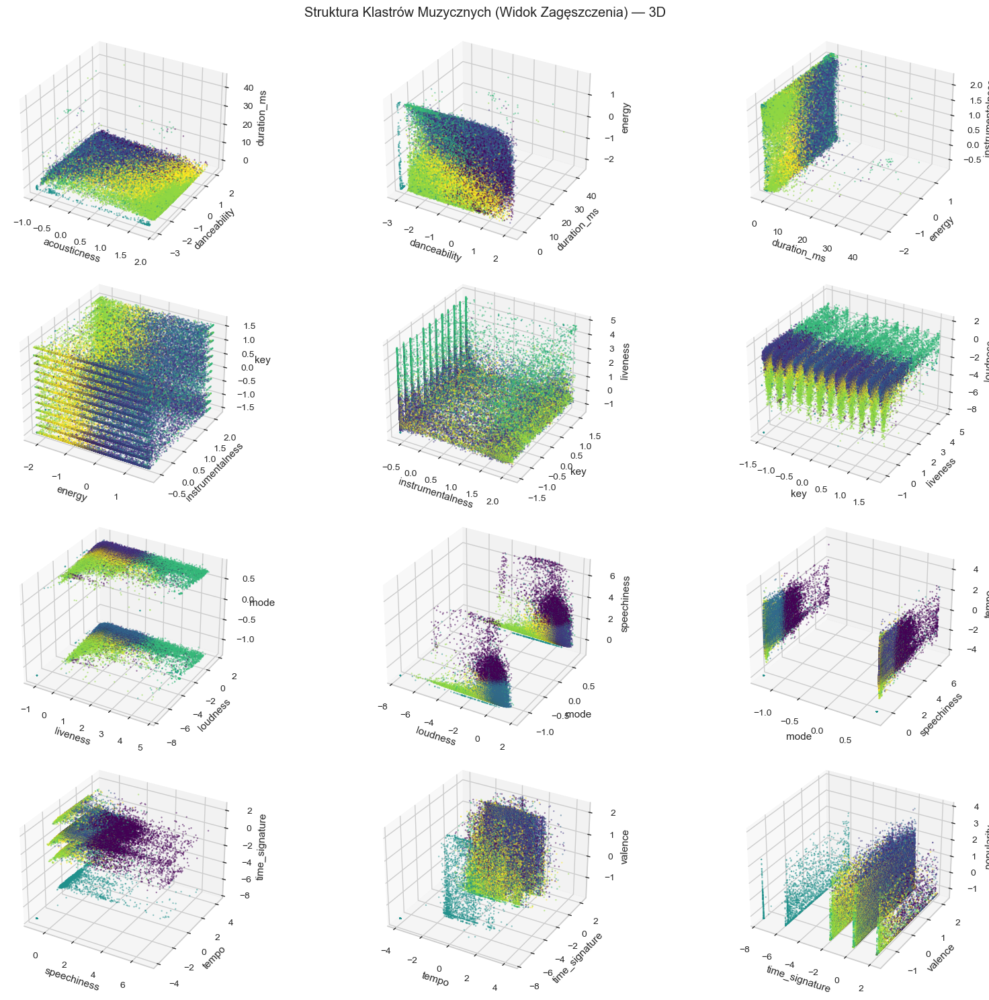

In [36]:

k = len(df_kmeans2.columns) - 2
ncols = 3
nrows = math.ceil(k / ncols)

fig, axes = plt.subplots(
    nrows, ncols,
    figsize=(18, 15),
    subplot_kw={"projection": "3d"}   
)
axes = axes.ravel()

for i in range(k):
    ax = axes[i]

    x = df_kmeans2.iloc[:, i]
    y = df_kmeans2.iloc[:, i+1]
    z = df_kmeans2.iloc[:, i+2]

    ax.scatter(
        x, y, z,
        c=labels2,          
        cmap="viridis",     
        s=3,
        alpha=0.5,
        linewidths=0
    )

    ax.set_xlabel(df_kmeans2.columns[i])
    ax.set_ylabel(df_kmeans2.columns[i+1])
    ax.set_zlabel(df_kmeans2.columns[i+2])

for j in range(k, len(axes)):
    axes[j].axis("off")

fig.suptitle("Struktura Klastrów Muzycznych (Widok Zagęszczenia) — 3D")
plt.tight_layout()
plt.savefig('Kmeans bez PCA obrazki_3D.png')
plt.show()


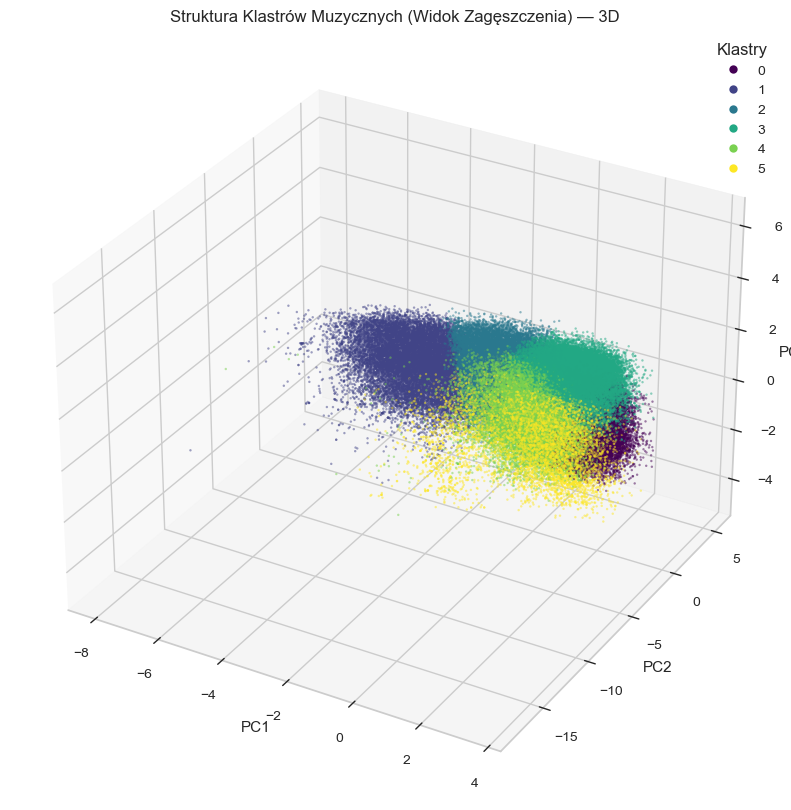

In [37]:
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

x = df_clustering.iloc[:, 0]
y = df_clustering.iloc[:, 1]
z = df_clustering.iloc[:, 2]


sc = ax.scatter(
    x, y, z,
    c=labels,          
    cmap='viridis',    
    s=3,               
    alpha=0.5,        
    linewidths=0      
)


ax.set_xlabel(df_clustering.columns[0])
ax.set_ylabel(df_clustering.columns[1])
ax.set_zlabel(df_clustering.columns[2])
plt.title("Struktura Klastrów Muzycznych (Widok Zagęszczenia) — 3D")


unique_labels = np.unique(labels)
handles = [
    plt.Line2D([0], [0], marker='o', linestyle='',
               markersize=6, markerfacecolor=sc.cmap(sc.norm(l)), markeredgewidth=0)
    for l in unique_labels
]
ax.legend(handles, [str(l) for l in unique_labels], title="Klastry", loc='upper right')
plt.savefig('PCA KMEANS 3D.png')
plt.show()

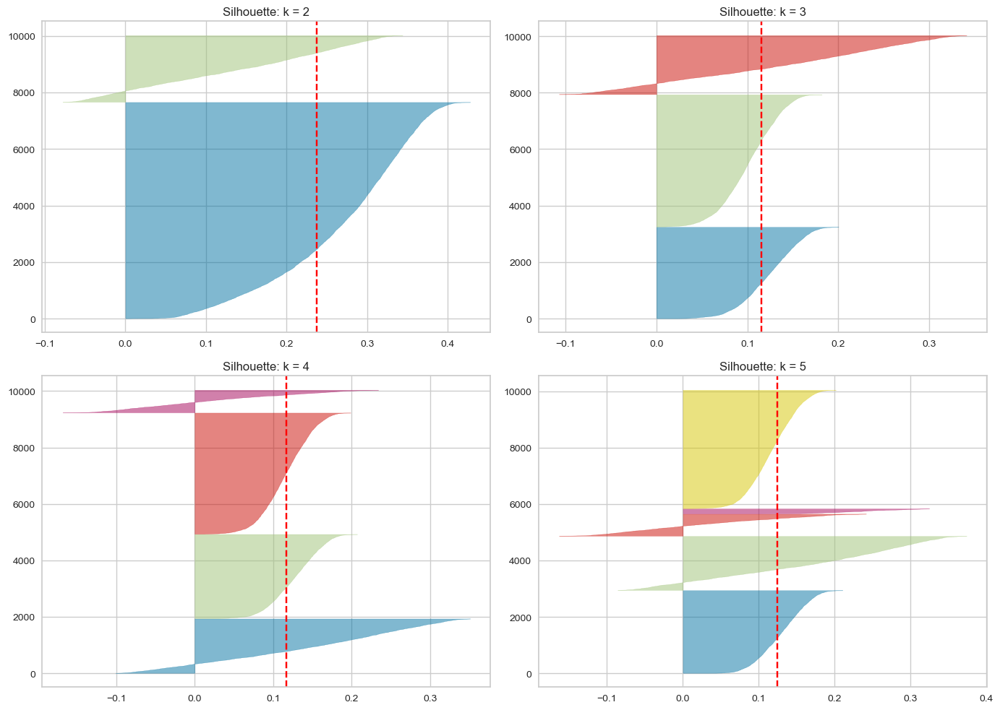

In [38]:

df_sil2 = df_kmeans2.sample(10000, random_state=0)

ks = list(range(2, 6))          # 2,3,4,5
i = len(ks)
ncols = 2
nrows = math.ceil(i / ncols)

fig, axes = plt.subplots(nrows, ncols, figsize=(14, 10))
axes = axes.ravel()

for idx, k in enumerate(ks):
    ax = axes[idx]

    kmeans = KMeans(init="k-means++", n_clusters=k, n_init=10, random_state=0)
    viz = SilhouetteVisualizer(kmeans, colors='yellowbrick', ax=ax)

    viz.fit(df_sil2)

    ax.set_title(f"Silhouette: k = {k}")
    
for j in range(n, len(axes)):
    axes[j].axis("off")

plt.tight_layout()
plt.savefig('shilouetter kmeans.png')
plt.show()


In [39]:
df_sil2

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,valence,popularity
128989,-0.990769,-0.270778,0.293825,1.647278,2.106372,0.490774,2.921994,-0.129424,0.803395,-0.280029,0.515348,0.235251,-1.341409,-0.010601
18023,-0.988283,-0.891581,-0.225279,1.397576,-0.581745,0.768345,0.394161,0.659806,-1.244718,-0.048380,0.517503,0.235251,-1.533243,-0.619333
99530,0.267619,-0.491742,0.560546,0.640788,-0.621703,-0.897079,-0.745748,0.671419,-1.244718,-0.600154,0.815187,0.235251,-0.168406,-1.228065
97367,1.861767,-0.739011,2.234426,-1.587318,1.770565,-0.064367,3.184316,-2.208315,0.803395,-0.493177,0.467569,0.235251,-0.944232,0.445947
35567,-0.751652,0.781432,-0.106022,0.406453,-0.621709,-1.452220,-0.494157,0.436560,-1.244718,-0.436874,0.811175,0.235251,-0.681764,-0.061329
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32289,-0.949835,0.413159,0.262117,1.474408,-0.620277,-0.897079,0.227229,0.734680,0.803395,-0.298528,1.475841,0.235251,1.240434,-0.365695
48589,0.597443,0.876131,-0.713900,-0.588512,-0.621709,1.601056,0.364352,0.304691,0.803395,-0.568785,0.351088,0.235251,-0.500351,-0.264240
117704,-0.212650,-0.086641,0.029848,1.324587,-0.621709,-0.064367,0.853225,0.710384,-1.244718,1.166164,-1.474074,0.235251,0.283195,1.206862
88735,-0.738054,0.518380,0.214453,0.241266,-0.621709,-1.174649,-0.801193,0.505475,-1.244718,1.367247,1.699651,0.235251,1.614838,-0.619333


In [40]:
  # nie ucina tekstu w komórkach
pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.expand_frame_repr', False)  
pd.set_option('display.width', 2000)              
pd.set_option('display.max_columns', None)

for i in range(kmeans2_elbow):
    subset = df_songs_clusters_kmeans[df_songs_clusters_kmeans['CLusters']==i].sample(n=10, random_state=2137)
    print(f'\n---------------- cluster: {i} ----------------')
    print(subset)


---------------- cluster: 0 ----------------
        CLusters                                 Song Name   Artist Name
69958          0                                      Okay      Lil Drip
2648           0                                      Poof       Lud Foe
18262          0                                Trunk Junk      Mad Zach
90501          0                                 Big Bandz     Solo Dolo
100463         0                         Bijali Ke Pol Par    Nitu Singh
89963          0         Hengel (feat. Lucass & Kwaamoody)        JoeyAK
16813          0                     Space Odyssey (CC564)         ATHOM
16032          0                              Way Too Many         Mckay
29449          0  Packing More Heat Cuz Jewels More Frozer  DopemanBeats
128058         0                             Today - Intro        DaBaby

---------------- cluster: 1 ----------------
        CLusters              Song Name           Artist Name
71035          1                 Iconic    

In [62]:
df_variance

,Explained Variance %
PC1,24.03
PC2,9.36
PC3,8.46
PC4,8.20
PC5,7.46
PC6,6.95
PC7,6.53
PC8,6.38
PC9,6.00
PC10,5.19


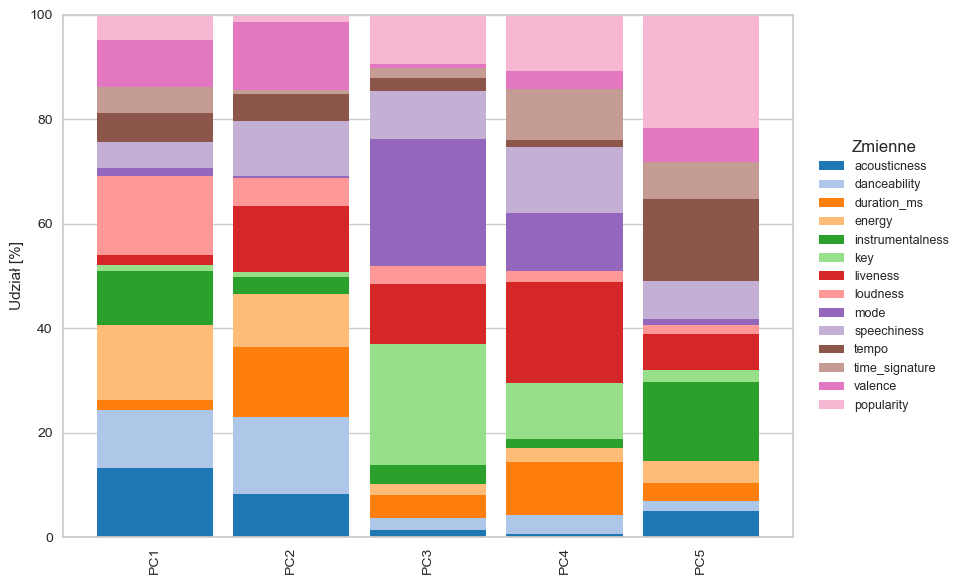

In [122]:
import matplotlib.pyplot as plt
from matplotlib import colormaps

df = df_pca_components.iloc[:final_pca.shape[0], :]

# % udziały (100% stacked)
shares = df.abs().div(df.abs().sum(axis=1), axis=0).mul(100)

# --- UNIKALNE KOLORY 1:1 dla kolumn ---
cols = list(shares.columns)
n = len(cols)

base = list(colormaps["tab20"].colors)      
base += list(colormaps["tab20b"].colors)   
base += list(colormaps["tab20c"].colors)    

if n <= len(base):
    colors = base[:n]
else:

    hsv = colormaps["hsv"]
    colors = [hsv(i / n) for i in range(n)]

color_map = dict(zip(cols, colors))

ax = shares.plot(
    kind="bar",
    stacked=True,
    figsize=(12, 6),
    color=[color_map[c] for c in cols], 
    width=0.85
)

ax.set_ylabel("Udział [%]")
ax.set_xlabel("")
ax.set_ylim(0, 100)

ax.legend(
    title="Zmienne",
    loc="center left",
    bbox_to_anchor=(1.02, 0.5),
    frameon=False,
    fontsize=9,
    ncol=1
)

plt.tight_layout(rect=[0, 0, 0.82, 1])
plt.show()

